In [73]:
import pickle

%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter
import seaborn as sns

from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler, PowerTransformer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.feature_selection import RFE, RFECV
from sklearn.model_selection import train_test_split, cross_validate, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import (
    accuracy_score, 
    balanced_accuracy_score,
    brier_score_loss, 
    f1_score,
    precision_score,
    recall_score,
    precision_recall_curve,
    PrecisionRecallDisplay,
    roc_auc_score,
    roc_curve,
    RocCurveDisplay,
    classification_report, 
    confusion_matrix, 
    ConfusionMatrixDisplay,
    get_scorer_names
)

from lightgbm import LGBMClassifier

import optuna

In [2]:
df = pd.read_pickle("../data/processed/df_log_reg.pkl")

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   customerID        7043 non-null   object  
 1   gender            7043 non-null   category
 2   SeniorCitizen     7043 non-null   category
 3   Partner           7043 non-null   category
 4   Dependents        7043 non-null   category
 5   PhoneService      7043 non-null   category
 6   MultipleLines     7043 non-null   category
 7   InternetService   7043 non-null   category
 8   OnlineSecurity    7043 non-null   category
 9   OnlineBackup      7043 non-null   category
 10  DeviceProtection  7043 non-null   category
 11  TechSupport       7043 non-null   category
 12  StreamingTV       7043 non-null   category
 13  StreamingMovies   7043 non-null   category
 14  Contract          7043 non-null   category
 15  PaperlessBilling  7043 non-null   category
 16  PaymentMethod     7043 n

In [4]:
customer_id = df["customerID"].copy()
X = df.drop(columns=["customerID", "Churn"], axis=1).copy()
y = df.loc[:, "Churn"].copy()

In [5]:
scores = ["accuracy", "precision", "recall", "f1"]

In [6]:
cw = X.shape[0] / (y.nunique() * y.value_counts())
cw_dict = {y.value_counts().index[0]: cw[0], y.value_counts().index[1]: cw[1]}

In [7]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7043 entries, 0 to 7042
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype   
---  ------            --------------  -----   
 0   gender            7043 non-null   category
 1   SeniorCitizen     7043 non-null   category
 2   Partner           7043 non-null   category
 3   Dependents        7043 non-null   category
 4   PhoneService      7043 non-null   category
 5   MultipleLines     7043 non-null   category
 6   InternetService   7043 non-null   category
 7   OnlineSecurity    7043 non-null   category
 8   OnlineBackup      7043 non-null   category
 9   DeviceProtection  7043 non-null   category
 10  TechSupport       7043 non-null   category
 11  StreamingTV       7043 non-null   category
 12  StreamingMovies   7043 non-null   category
 13  Contract          7043 non-null   category
 14  PaperlessBilling  7043 non-null   category
 15  PaymentMethod     7043 non-null   category
 16  tenure            7043 n

In [ ]:
X_cat_feat = X.select_dtypes(include="category").columns.to_list()
X_num_feat = X.select_dtypes(exclude="category").columns.to_list()

X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2025)

In [121]:
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=2025)

lr_estimator = LogisticRegression(C=1, n_jobs=-1, random_state=2025)

rfecv = RFECV(
    estimator=lr_estimator,
    step=1,
    cv=5,
    scoring="precision",
    n_jobs=-1
)

cat_preproc = Pipeline(
    steps=[
        ("encoder", OneHotEncoder(drop="first", sparse_output=True))
    ]
)

num_preproc = Pipeline(
    steps=[
        ("scaler", StandardScaler())
    ]
)

lr_preprocessor = ColumnTransformer(
    transformers=[
        ("cat", cat_preproc, X_cat_feat), 
        ("num", num_preproc, X_num_feat)
    ]
)

lr_dev_pipe = Pipeline(
    steps=[
        ("lr_preprocessor", lr_preprocessor),
        ("lr_feat_select", rfecv),
        ("lr_clf", lr_estimator)
    ]
)

param_grid = {
    #"lr_feat_select__C": np.linspace(1e-3, 1, 10), 
    "lr_clf__C": np.linspace(1e-3, 1, 10)
}

lr_gs = GridSearchCV(lr_dev_pipe, param_grid, scoring="precision", cv=kfold, n_jobs=-1)
lr_gs.fit(X_train_val, y_train_val)
#lr_cv = cross_validate(lr_dev_pipe, X_train_val, y_train_val, cv=kfold, scoring='accuracy')

,estimator,Pipeline(step...state=2025))])
,param_grid,"{'lr_clf__C': array([0.001,... 1. ])}"
,scoring,'precision'
,n_jobs,-1
,refit,True
,cv,StratifiedKFo... shuffle=True)
,verbose,0
,pre_dispatch,'2*n_jobs'
,error_score,nan
,return_train_score,False
,transformers,"[('cat', ...), ('num', ...)]"


In [118]:
lr_gs.best_estimator_.named_steps["lr_feat_select"].support_

array([False,  True, False,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True, False,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True, False,
        True,  True,  True])

In [119]:
best_C = lr_gs.best_params_["lr_clf__C"]

In [120]:
lr_gs_cv_results = pd.DataFrame(lr_gs.cv_results_).sort_values(by="rank_test_score")
lr_gs_cv_results

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_lr_clf__C,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,5.018944,0.393639,0.045781,0.018621,0.001,{'lr_clf__C': 0.001},1.000000,0.800000,0.000000,0.944444,0.923077,0.733504,0.372533,1
1,5.566169,1.539569,0.037766,0.011083,0.112,{'lr_clf__C': 0.112},0.622951,0.660305,0.691983,0.674510,0.641221,0.658194,0.024259,2
2,5.287654,0.485851,0.065642,0.040109,0.223,{'lr_clf__C': 0.223},0.625000,0.655431,0.679012,0.677043,0.640152,0.655327,0.020893,3
3,4.822496,0.791470,0.053689,0.012979,0.334,{'lr_clf__C': 0.334},0.626506,0.652985,0.673387,0.677043,0.640152,0.654015,0.019264,4
6,4.976126,0.721881,0.060519,0.029420,0.667,{'lr_clf__C': 0.667},0.622490,0.652985,0.668000,0.675676,0.641509,0.652132,0.018965,5
5,4.897152,0.745835,0.051489,0.019554,0.556,{'lr_clf__C': 0.556},0.625000,0.650558,0.668000,0.674419,0.641509,0.651897,0.017887,6
4,5.188993,0.880875,0.076520,0.024132,0.445,{'lr_clf__C': 0.445},0.625000,0.650558,0.668000,0.674419,0.640152,0.651626,0.018052,7
8,4.540239,0.613909,0.053645,0.037165,0.889,{'lr_clf__C': 0.889},0.622490,0.651685,0.665339,0.676923,0.641509,0.651589,0.018864,8
7,4.778544,0.884455,0.072992,0.035880,0.778,{'lr_clf__C': 0.778},0.622490,0.652985,0.665339,0.674330,0.641509,0.651331,0.018200,9
9,3.556611,0.538415,0.017925,0.004607,1.000,{'lr_clf__C': 1.0},0.622490,0.652985,0.665339,0.674330,0.641509,0.651331,0.018200,9


In [ ]:
lr_cv["test_score"].mean()

np.float64(0.8012048838378505)

In [ ]:
lr_dev_pipe.fit(X_train_val, y_train_val)

,steps,"[('log_reg_preprocessor', ...), ('log_reg_feat_select', ...), ...]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('cat', ...), ('num', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


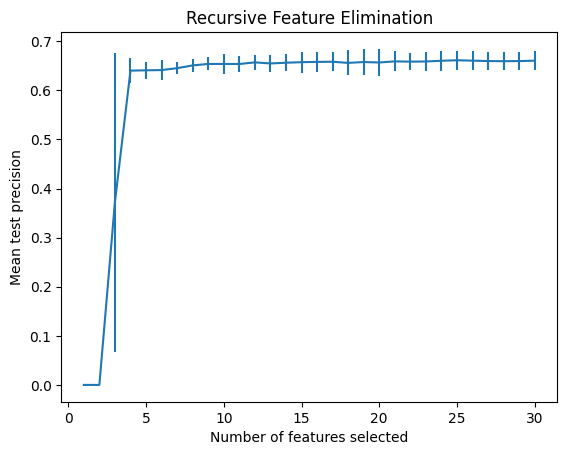

In [ ]:
rfe_data = {
    key: value 
    for key, value in lr_dev_pipe.named_steps["log_reg_feat_select"].cv_results_.items() 
    if key in ["n_features", "mean_test_score", "std_test_score"]
}
rfe_results = pd.DataFrame(rfe_data)

plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Mean test precision")
plt.errorbar(
    x=rfe_results["n_features"],
    y=rfe_results["mean_test_score"],
    yerr=rfe_results["std_test_score"]
)
plt.title("Recursive Feature Elimination")
plt.show()

In [ ]:
y_test_pred_labels = lr_dev_pipe.predict(X_test)
y_test_pred_probas = lr_dev_pipe.predict_proba(X_test)

acc = accuracy_score(y_test, y_test_pred_labels)
bal_acc = balanced_accuracy_score(y_test, y_test_pred_labels)
rec = recall_score(y_test, y_test_pred_labels)
prec = precision_score(y_test, y_test_pred_labels)
f1 = f1_score(y_test, y_test_pred_labels)
brier = brier_score_loss(y_test, y_test_pred_probas)
roc_auc = roc_auc_score(y_test, y_test_pred_labels)

metrics = {
    "accuracy": acc,
    "balanced_accuracy": bal_acc,
    "recall": rec,
    "precision": prec,
    "f1_score": f1,
    "brier_score": brier,
    "roc_auc": roc_auc
}

df_metrics = pd.DataFrame(metrics, index=["Logistic Regression"])

df_metrics

,accuracy,balanced_accuracy,recall,precision,f1_score,brier_score,roc_auc
Logistic Regression,0.806246,0.722554,0.553371,0.633441,0.590705,0.137593,0.722554


              precision    recall  f1-score   support

           0       0.86      0.89      0.87      1053
           1       0.63      0.55      0.59       356

    accuracy                           0.81      1409
   macro avg       0.74      0.72      0.73      1409
weighted avg       0.80      0.81      0.80      1409



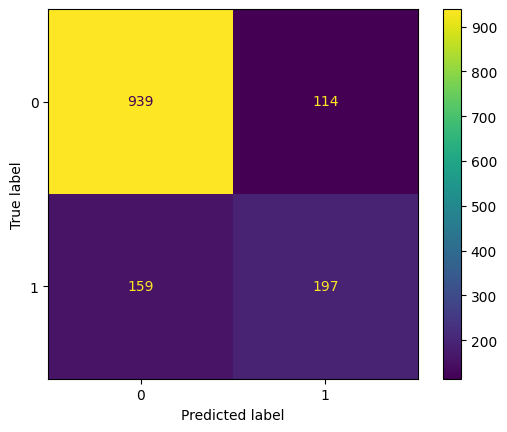

In [49]:
print(classification_report(y_test, y_test_pred_labels))

cm_plot = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(y_test, y_test_pred_labels))

cm_plot.plot()
plt.show()

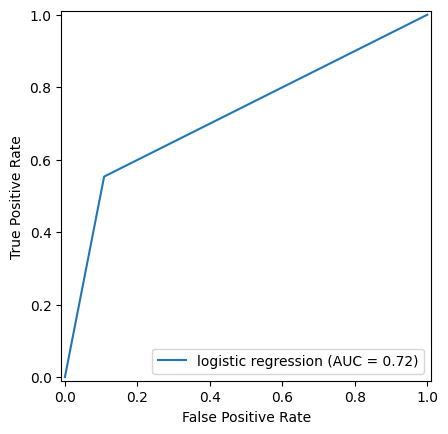

In [58]:
roc_auc = roc_auc_score(y_test, y_test_pred_labels)
fpr, tpr, thresholds = roc_curve(y_test, y_test_pred_labels)
roc_display = RocCurveDisplay(fpr=fpr, tpr=tpr, roc_auc=roc_auc, name="logistic regression")
roc_display.plot()
plt.show()

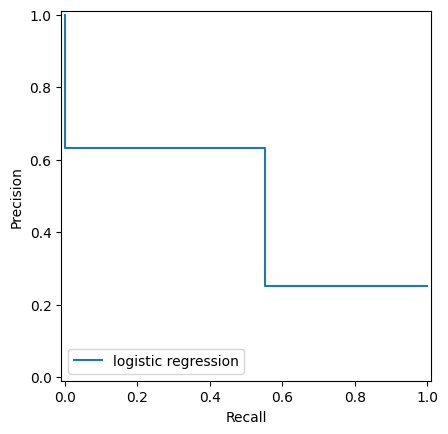

In [65]:
precision = precision_score(y_test, y_test_pred_labels)
recall = recall_score(y_test, y_test_pred_labels)
prec_rec_curve = precision_recall_curve(y_test, y_test_pred_labels)
prec_rec_display = PrecisionRecallDisplay(
    precision=prec_rec_curve[0], 
    recall=prec_rec_curve[1], 
    #average_precision=precision,
    estimator_name="logistic regression"
)
prec_rec_display.plot()
plt.show()

In [62]:
X_cat_feat = X.select_dtypes(include="category").columns.to_list()
X_num_feat = X.select_dtypes(exclude="category").columns.to_list()

X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2025)

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=2025)

def objective(trial):
    
    num_leaves = trial.suggest_int("num_leaves", 4, 32, step=4)
    max_depth = trial.suggest_int("max_depth", -1, 11, step=2)
    learning_rate = trial.suggest_float("learning_rate", 1e-4, 1, log=True)
    n_estimators = trial.suggest_int("n_estimators", 1e2, 1e3, step=1e2)
    reg_alpha = trial.suggest_float("reg_alpha", 1e-4, 1, log=True)
    reg_lambda = trial.suggest_float("reg_lambda", 1e-4, 1, log=True)
    
    base_estimator = LGBMClassifier(
        num_leaves=num_leaves, 
        max_depth=max_depth, 
        learning_rate=learning_rate,
        n_estimators=n_estimators,
        reg_alpha=reg_alpha,
        reg_lambda=reg_lambda,
        n_jobs=-1, 
        random_state=2025
    )

    rfecv = RFECV(
        estimator=base_estimator,
        step=1,
        cv=3,
        scoring="accuracy",
        n_jobs=-1
    )
    
    pipe_cat = Pipeline(
        steps=[
            ("encoder", OneHotEncoder(drop="first", sparse_output=True))
        ]
    )
    
    pipe_num = Pipeline(
        steps=[
            ("scaler", StandardScaler())
        ]
    )

    lgbm_preprocessor = ColumnTransformer(
        transformers=[
            ("cat", pipe_cat, X_cat_feat), 
            ("num", pipe_num, X_num_feat)
        ]
    )
    
    lgbm_pipe = Pipeline(
        steps=[
            ("lgbm_preprocessor", lgbm_preprocessor),
            ("lgbm_feat_select", rfecv),
            ("lgbm_clf", base_estimator)
        ]
    )
    
    scores = cross_validate(lgbm_pipe, X_train_val, y_train_val, cv=outer_cv, scoring="accuracy")["test_score"]
    mean_accuracy = scores.mean()
    #std_accuracy = scores.std()
    
    return mean_accuracy #{"accuracy (mean)": mean_accuracy, "accuracy (std)": std_accuracy}

study = optuna.create_study(direction="maximize", study_name="lgbm_study")
study.optimize(objective, n_trials=10)

print("Best parameters: ", study.best_params)
print("Best accuracy: ", study.best_value)

[I 2025-08-04 18:28:46,158] A new study created in memory with name: lgbm_study


[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268693 -> initscore=-1.001263
[LightGBM] [Info] Start training from score -1.001263
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000383 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000299 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000329 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:30:54,857] Trial 0 finished with value: 0.8045771401463512 and parameters: {'num_leaves': 28, 'max_depth': 1, 'learning_rate': 0.02224945994967322, 'n_estimators': 900, 'reg_alpha': 0.010173112059701577, 'reg_lambda': 0.00724005485140363}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000569 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000392 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000428 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000471 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000373 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000149 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:35:50,178] Trial 1 finished with value: 0.749911505261615 and parameters: {'num_leaves': 16, 'max_depth': -1, 'learning_rate': 0.0008092308620301653, 'n_estimators': 700, 'reg_alpha': 0.00015329971498543587, 'reg_lambda': 0.0003550388053200579}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000343 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268693 -> initscore=-1.001263
[LightGBM] [Info] Start training from score -1.001263
[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000441 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000275 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000352 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000503 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000421 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000326 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000314 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000352 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in 

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:40:06,632] Trial 2 finished with value: 0.7967683266062623 and parameters: {'num_leaves': 20, 'max_depth': 9, 'learning_rate': 0.009199859516586929, 'n_estimators': 600, 'reg_alpha': 0.029821176466405, 'reg_lambda': 0.004159573572720363}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000703 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268693 -> initscore=-1.001263
[LightGBM] [Info] Start training from score -1.001263
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000382 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000313 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000293 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000416 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:43:01,098] Trial 3 finished with value: 0.7994297881327215 and parameters: {'num_leaves': 8, 'max_depth': 3, 'learning_rate': 0.01694297368153372, 'n_estimators': 1000, 'reg_alpha': 0.016505861399968118, 'reg_lambda': 0.0006078964496205953}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000373 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268693 -> initscore=-1.001263
[LightGBM] [Info] Start training from score -1.001263
[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000443 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000301 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000508 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000408 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000273 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000287 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:44:10,360] Trial 4 finished with value: 0.7974773877424937 and parameters: {'num_leaves': 4, 'max_depth': 9, 'learning_rate': 0.006163189186723989, 'n_estimators': 500, 'reg_alpha': 0.04706545502413509, 'reg_lambda': 0.0003822769396913902}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268693 -> initscore=-1.001263
[LightGBM] [Info] Start training from score -1.001263
[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000428 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000304 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000367 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000376 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000294 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000271 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000461 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:50:42,658] Trial 5 finished with value: 0.7712104472648585 and parameters: {'num_leaves': 28, 'max_depth': -1, 'learning_rate': 0.2441390729781209, 'n_estimators': 900, 'reg_alpha': 0.06248022478529371, 'reg_lambda': 0.009519223445194019}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000425 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268693 -> initscore=-1.001263
[LightGBM] [Info] Start training from score -1.001263
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000308 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000324 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:51:47,466] Trial 6 finished with value: 0.731451959886588 and parameters: {'num_leaves': 32, 'max_depth': 5, 'learning_rate': 0.0001777281343965942, 'n_estimators': 100, 'reg_alpha': 0.012880100583252004, 'reg_lambda': 0.01627243520995473}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000324 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000268 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:57:10,637] Trial 7 finished with value: 0.731451959886588 and parameters: {'num_leaves': 32, 'max_depth': 3, 'learning_rate': 0.00011426950625056783, 'n_estimators': 800, 'reg_alpha': 0.0001428150299752116, 'reg_lambda': 0.036385146622919175}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000492 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268693 -> initscore=-1.001263
[LightGBM] [Info] Start training from score -1.001263
[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000354 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000260 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000338 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000284 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000296 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000290 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000568 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000521 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000315 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:58:03,826] Trial 8 finished with value: 0.7878936361014403 and parameters: {'num_leaves': 8, 'max_depth': 9, 'learning_rate': 0.00619933712307307, 'n_estimators': 200, 'reg_alpha': 0.00010810944303223857, 'reg_lambda': 0.017947590675592404}. Best is trial 0 with value: 0.8045771401463512.


[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000504 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268693 -> initscore=-1.001263
[LightGBM] [Info] Start training from score -1.001263
[LightGBM] [Info] Number of positive: 1211, number of negative: 3296
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000288 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000365 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000551 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000318 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268471 -> initscore=-1.002393
[LightGBM] [Info] Start training from score -1.002393
[LightGBM] [Info] Number of positive: 1210, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000285 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4507, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000307 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268634 -> initscore=-1.001566
[LightGBM] [Info] Start training from score -1.001566
[LightGBM] [Info] Number of positive: 1211, number of negative: 3297
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 4508, number of used features: 29
[LightGBM] [Info] [binary:

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
[I 2025-08-04 18:59:56,815] Trial 9 finished with value: 0.731451959886588 and parameters: {'num_leaves': 20, 'max_depth': 7, 'learning_rate': 0.0007692810270655808, 'n_estimators': 200, 'reg_alpha': 0.0016484246706639119, 'reg_lambda': 0.47225157729313855}. Best is trial 0 with value: 0.8045771401463512.


Best parameters:  {'num_leaves': 28, 'max_depth': 1, 'learning_rate': 0.02224945994967322, 'n_estimators': 900, 'reg_alpha': 0.010173112059701577, 'reg_lambda': 0.00724005485140363}
Best accuracy:  0.8045771401463512


In [67]:
print(f"Best accuracy: {study.best_value:.4f}")
print(f"Best params: {study.best_params}")

Best accuracy: 0.8046
Best params: {'num_leaves': 28, 'max_depth': 1, 'learning_rate': 0.02224945994967322, 'n_estimators': 900, 'reg_alpha': 0.010173112059701577, 'reg_lambda': 0.00724005485140363}


In [75]:
final_lgbm = LGBMClassifier(
    num_leaves=study.best_params["num_leaves"], 
    max_depth=study.best_params["max_depth"], 
    learning_rate=study.best_params["learning_rate"],
    n_estimators=study.best_params["n_estimators"],
    reg_alpha=study.best_params["reg_alpha"],
    reg_lambda=study.best_params["reg_lambda"],
    n_jobs=-1, 
    random_state=2025
)

rfecv = RFECV(
        estimator=base_estimator,
        step=1,
        cv=3,
        scoring="accuracy",
        n_jobs=-1
    )
    
pipe_cat = Pipeline(
    steps=[
        ("encoder", OneHotEncoder(drop="first", sparse_output=True))
    ]
)

pipe_num = Pipeline(
    steps=[
        ("scaler", StandardScaler())
    ]
)

final_lgbm_preprocessor = ColumnTransformer(
    transformers=[
        ("cat", pipe_cat, X_cat_feat), 
        ("num", pipe_num, X_num_feat)
    ]
)

final_lgbm_pipe = Pipeline(
    steps=[
        ("lgbm_preprocessor", final_lgbm_preprocessor),
        ("lgbm_feat_select", rfecv),
        ("lgbm_clf", final_lgbm)
    ]
)

final_lgbm_fitted = final_lgbm_pipe.fit(X_train_val, y_train_val)

[LightGBM] [Info] Number of positive: 1513, number of negative: 4121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000360 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 622
[LightGBM] [Info] Number of data points in the train set: 5634, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.268548 -> initscore=-1.002001
[LightGBM] [Info] Start training from score -1.002001
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

In [70]:
y_test_pred_labels = final_lgbm_pipe.predict(X_test)
y_test_pred_probas = final_lgbm_pipe.predict_proba(X_test)

precision_score(y_test, y_test_pred_labels)

c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
c:\Users\Leonardo.Oliveira\Documents\Python\kaggle\telco-customer-churn\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(


0.6333333333333333

In [76]:
with open("../models/lgbm_model_pipeline.pkl", "wb") as f:
    pickle.dump(final_lgbm_pipe, f)
    
with open("../models/lgbm_model.pkl", "wb") as f:
    pickle.dump(final_lgbm_fitted, f)

In [53]:
X_cat_feat = X.select_dtypes(include="category").columns.to_list()
X_num_feat = X.select_dtypes(exclude="category").columns.to_list()

X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2025)

outer_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=2025)

def objective(trial):
    
    C = trial.suggest_float("C", 1e-3, 1e2, log=True)
    
    base_estimator = LogisticRegression(C=C, solver="lbfgs", max_iter=1000, n_jobs=-1, random_state=2025)

    rfecv = RFECV(
        estimator=base_estimator,
        step=1,
        cv=3,
        scoring="accuracy",
        n_jobs=-1
    )

    pipe_cat = Pipeline(
        steps=[
            ("encoder", OneHotEncoder(drop="first", sparse_output=True))
        ]
    )
    
    pipe_num = Pipeline(
        steps=[
            ("scaler", StandardScaler())
        ]
    )

    log_reg_preprocessor = ColumnTransformer(
        transformers=[
            ("cat", pipe_cat, X_cat_feat), 
            ("num", pipe_num, X_num_feat)
        ]
    )
    
    log_reg_pipe = Pipeline(
        steps=[
            ("log_reg_preprocessor", log_reg_preprocessor),
            ("log_reg_feat_select", rfecv),
            ("log_reg_clf", base_estimator)
        ]
    )
    
    scores = cross_validate(log_reg_pipe, X, y, cv=outer_cv, scoring="accuracy")["test_score"]
    mean_accuracy = scores.mean()
    #std_accuracy = scores.std()
    
    return mean_accuracy #{"accuracy (mean)": mean_accuracy, "accuracy (std)": std_accuracy}

study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=10)

print("Best parameters: ", study.best_params)
print("Best accuracy: ", study.best_value)

[I 2025-08-04 17:56:30,122] A new study created in memory with name: no-name-5be5813e-752a-433c-ab4f-19ce946f093c
[I 2025-08-04 17:57:22,760] Trial 0 finished with value: 0.8047715780050326 and parameters: {'C': 70.64832663253588}. Best is trial 0 with value: 0.8047715780050326.
[I 2025-08-04 17:58:04,220] Trial 1 finished with value: 0.804061753984128 and parameters: {'C': 0.2077057026760919}. Best is trial 0 with value: 0.8047715780050326.
[I 2025-08-04 17:58:49,432] Trial 2 finished with value: 0.8053395581973032 and parameters: {'C': 2.7954244397959993}. Best is trial 2 with value: 0.8053395581973032.
[I 2025-08-04 17:59:35,295] Trial 3 finished with value: 0.8047715780050326 and parameters: {'C': 36.77357290804333}. Best is trial 2 with value: 0.8053395581973032.
[I 2025-08-04 18:00:13,358] Trial 4 finished with value: 0.7985241991418801 and parameters: {'C': 0.005232483705159903}. Best is trial 2 with value: 0.8053395581973032.
[I 2025-08-04 18:00:47,488] Trial 5 finished with va

Best parameters:  {'C': 2.4558971739456403}
Best accuracy:  0.8056234474804826
